# **Social graphs and interactions. Final Project.**

In [ ]:
import plotly.graph_objects as go
import plotly.io as pio
import community as community_louvain
import datetime
import matplotlib.cm as cm
import pandas as pd
import numpy as np

## **1. Motivation**

European airline’s passenger capacity growth in 2019 was the lowest since 2012. Therefore, airlines readjusted their strategies to face 2020, that according to analysts, was going to improve 2019's figures.

However, as we all know, Covid-19 came and changed everyone's lives and plans. The airline industry has been one of the most affected, having to cancel thousands of flights overnight. 

But the evident loss of profit is just one side of the coin. This situation forced companies to react immediately to customer refunds and complaints in different manners, challenging years of work in marketing and customer care policies.

We want to take a deeper look at this scenario by creating a network of European Airports connections at different time slots during the months January to October for 2019 and 2020. With these networks, we aim at visualizing the decrease in the flight traffic in Europe. To have a better perspective of the effect of the pandemic, 2020 data is compared against data from 2019.

Parallelly, we want to evaluate how passengers have perceived the airline´s handling of the situation. To do so, we analyze millions of tweets directed to the 10 of the most important airlines in Europe.


The datasets used for the analysis are:
- **Flights dataset**. Zenodo dataset, the data in this dataset is derived and cleaned from the full OpenSky dataset. It contains information of all the flights in Europe until October 2020. 
https://zenodo.org/record/4299838#.X9CIFBNKj8M 

- **Airports dataset**. Dataset containing all the airports in the world and its corresponding data such as the size, the coordinates, the id, the name, etc. https://ourairports.com/data/

- **Tweets dataset**. Extracted tweets from 2019 and 2020 directed to the 10 selected airlines.

All the graphics have been designed prioritizing the user experience and the interactivity of them.

## **2. Basic statistics of the dataset**

We work with Google Colab, so first of all we need to mount the Google drive.

In [ ]:
# Mount google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### **2.1. Import the dataset**

As mentioned before, the datasets used are: flights dataset, airports dataset and the tweets.

In this section, the cells contain the code for importing all the datasets.

#### 2.1.1. Import data of airports

In this section, we import the data of the airports from the airports csv file. 

Note that we apply a filter for getting only the airports in Europe.

In [ ]:
# Import data of airports to get airport name and airport ID
dir = "/content/drive/My Drive/Project/Raw data/"
filename = dir + "airports.csv"
df_airports = pd.read_csv(filename)
df_airports = df_airports[df_airports.continent == "EU"]

#### 2.1.2. Import data of flights

Now, we need to merge the airports data with the flights data, adding to it the information of the origin and destination airports.

Furthemore, we apply a filter to the airports dataset to obtain only the larger airports in Europe.

All this data, is saved in new files that are now ready to start the analysis.

In [ ]:
# Import data of flights and joining airports info to flights dataframe

# Import data of flights (origin, destination, airline, etc.)
import pandas as pd
import glob, os
dir = "/content/drive/My Drive/Project/Raw data/"
store_dir = "/content/drive/My Drive/Project/Data_19_20/"

# Creating new files for the data
filenames = dir + "flightlist_20*.csv"
filenames = glob.glob(filenames)

df_airports_origin = df_airports[['ident', 'type', 'name', 'continent', 'iso_country', 'municipality']].add_suffix('_origin')
df_airports_destination = df_airports[['ident', 'type', 'name', 'continent', 'iso_country', 'municipality']].add_suffix('_destination')

df_flights_all = pd.DataFrame()
total_lines = 0

for filename in filenames:
  df_flights = pd.read_csv(filename)

  df_flights = pd.merge(df_flights,
                  df_airports_origin,
                  left_on='origin', 
                  right_on='ident_origin',
                  how='left')
  df_flights = pd.merge(df_flights,
                 df_airports_destination,
                 left_on='destination', 
                 right_on='ident_destination',
                 how='left')

  df_flights = df_flights[(df_flights.continent_origin == "EU") & (df_flights.continent_destination == "EU")]
  df_flights = df_flights[(df_flights.type_origin == "large_airport") & (df_flights.type_destination == "large_airport")]

  file_lines = len(df_flights)
  total_lines = total_lines + file_lines
  print(os.path.basename(filename) + " " + str(file_lines))

  store_name = "EU_" + os.path.basename(filename)
  store_path = store_dir + store_name
  df_flights.to_csv(store_path, encoding='utf-8', index=False)

#### 2.1.3. Import final data

Once we created the new files with all the requiered information, we import them again into a dataframe to pursue the data analysis.

In [ ]:
# Import final data of flights with airports and all the information
import pandas as pd
import glob, os

dir = "/content/drive/My Drive/Project/Data_19_20/"

filenames = dir + "EU_flightlist_20*.csv"
filenames = glob.glob(filenames)

df_flights_all = pd.DataFrame()

for filename in filenames:
  df_flights = pd.read_csv(filename)
  df_flights_all = pd.concat([df_flights_all, df_flights], ignore_index=True)

### **2.2. Dataset statistics**

The first exploration on our dataset consists of observing the evolution over time of the daily number of flights. 

For this, we create a new dataframe with all the flights per day.

In [ ]:
# Create dataframe for daily flights
df_flights_daily = df_flights_all.copy(deep=True)

df_flights_daily['day'] = pd.to_datetime(df_flights_all['day'])
df_flights_daily = df_flights_daily[["callsign", "day"]].groupby(["day"]).agg("count")
df_flights_daily = df_flights_daily.reset_index()
df_flights_daily['year'] = df_flights_daily['day'].dt.year
# filter outliers with low amount of flights
df_flights_daily = df_flights_daily[df_flights_daily.callsign > 10]
df_flights_daily = df_flights_daily[((df_flights_daily.year == 2019) & (df_flights_daily.callsign > 4200)) | (df_flights_daily.year == 2020)]
# calc moving average
df_flights_daily['flights_rolling_mean_7_days'] = df_flights_daily["callsign"].rolling(window=7).mean()

In the next cell, the code for the plot of the temporal evolution of the number of daily flights.


In [ ]:
# Plot number of flights over time
dates = list(df_flights_daily['day'])
cnt_flights = list(df_flights_daily['callsign'])
cnt_flights_avg_7 = list(df_flights_daily['flights_rolling_mean_7_days'])

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=dates, y=cnt_flights,
                    mode='lines',
                    name='count of flights daily'))
fig.add_trace(go.Scatter(x=dates, y=cnt_flights_avg_7,
                    mode='lines',
                    name='count of flights daily - 7 days moving avg'))

# Edit the layout
fig.update_layout(title='Count of flights daily 2019-2020',
                   xaxis_title='Date',
                   yaxis_title='Count of flights',
                   legend=dict(
                                x=0.1,
                                y=0.1,
                                traceorder='normal',
                                font=dict(
                                    size=11,),
                            ),
                  width=1000,
                  height=600
                  )

fig.show()
pio.write_html(fig, file='/content/drive/My Drive/Project/plots_html/count_flights_daily.html', auto_open=True)

To get a smoother trend we calculate the rolling average for the last 7 days, see the red line in the plot.

In the plot above, it can clearly be observed a sharp decrease in mid-March 2020, when the first lock-downs in Europe occurred. In the worst period for air traffic, the reduction of flights accounted for roughly 90%.

### **2.3. Initialize the network**

For a better interpretation, the data of flights is represented as a network for each month. The nodes of the networks are the larger airports in Europe and the links represent all the flights between them.

The analysis has been conducted top-to-bottom, therefore the first plot shows all the flights in Europe, whereas the next plots are focused on the selected airlines.

The code in the following cells aims to organize the data and prepare it in order to create the network.


#### 2.3.1. Organizing the flights data for month and year

First, the data has to be organized for months and year, so we create new dataframes organized by month.

In [ ]:
# Number of flights per year-month
df_flights_all['day'] = pd.to_datetime(df_flights_all['day'])
df_flights_all['year'] = df_flights_all['day'].dt.year
df_flights_all['month'] = df_flights_all['day'].dt.month
df_flights_all['year-month'] = pd.to_datetime(df_flights_all[['year','month']].assign(day=1)).dt.to_period('M')
df_flights_all['day'] = df_flights_all['day'].dt.date
df_flights_all['airline'] = df_flights_all['callsign'].apply(lambda x: x[:3])
df_flights_all['route'] = df_flights_all[["origin", "destination"]].values.tolist()
# undirect routes
df_flights_all['route'] = df_flights_all['route'].apply(sorted)
df_flights_all['route'] = df_flights_all['route'].apply(lambda x: '-'.join(x))

df_flights_monthly = df_flights_all.copy(deep=True)
df_flights_monthly = df_flights_monthly[["callsign", "year-month", "airline", "route"]].groupby(["year-month", "route", "airline"]).agg("count")
df_flights_monthly = df_flights_monthly.reset_index()

df_flights_monthly["origin"] = df_flights_monthly['route'].apply(lambda x: x[:4])
df_flights_monthly["destination"] = df_flights_monthly['route'].apply(lambda x: x[5:])
df_flights_monthly = df_flights_monthly[df_flights_monthly["origin"] != df_flights_monthly["destination"]]
df_flights_monthly.reset_index(inplace=True, drop=True)

#### 2.3.2. Set nodes attributes

Next, we set the requiered attributes for the nodes: name of the airport, country and coordinates.

In [ ]:
# Set nodes attributes (airport attributes: position, country, name, id)
airport_attr = dict()
positions = dict()

for index, row in df_airports.iterrows():
  #print(row)
  id = row['ident']
  if id not in airport_attr.keys():
    airport_attr[id] = dict()
    
  airport_attr[id]['name'] = row['name']
  airport_attr[id]['country'] = row['iso_country']
  airport_attr[id]['latitude'] = row['latitude_deg']
  airport_attr[id]['longitude'] = row['longitude_deg']
  positions[id] = [row['longitude_deg'], row['latitude_deg']]

#### 2.3.3. Set airline codes and colors

To go deeper in detail we analyze the effect of the pandemic on 10 of the most important airlines in Europe.

For this analysis we need to initialize the data of the ten selected airlines: Air France, British Airways, EasyJet, Iberia, KLM, Lufthansa, Norwegian, Ryanair, Scandinavian Airlines and Vueling.

In the next cell, we create two dictionaries which assign to each airline a color and their full name.

In [ ]:
# Set airline codes and colors
airline_codes = ['DLH', 'BAW', 'RYR', 'IBE', 'SAS', 'VLG', 'AFR', 'KLM', 'NAX', 'EZY']
airline_colors = {'DLH': '#000099', 'BAW': '#800000' , 'RYR': '#3366ff', 'IBE': '#ff9933', 'SAS': '#33ccff', 'VLG': '#ffff00', 'AFR': '#009999', 'KLM': '#6699ff', 'NAX': '#ff3300', 'EZY': '#EF9C32'}
airline_names = {'DLH': 'Lufthansa', 'BAW': 'British Airways' , 'RYR': 'Ryanair', 'IBE': 'Iberia', 'SAS': 'SAS', 'VLG': 'Vueling', 'AFR': 'Air France', 'KLM': 'KLM', 'NAX': 'Norwegian', 'EZY': 'Easyjet'}

#### 2.3.4. Create network for each month from 2019 and 2020

To create the networks, we define a function that initializes a MultiGraph for a given dataframe. We used MultiGraph, as in our case there are more than one link betwen the same two airports, correspoding to different flights. Notice that we haven't considered the direction of the flights as all the flights that arrive at one airport will leave again at some point.

For each month, it creates a different network and returns a dictionary of monthly networks. It assigns attributes to the nodes (name, country, coordinates) and the edges (origin, destination, number of fligths for this route, airline and color of the airline).

In [ ]:
# Create flight network for each month
import networkx as nx

def create_networks(df_flights_monthly):
  # Nodes -> Airports in Europe
  G_months = dict() # list of graphs per year-month

  for year_month in df_flights_monthly["year-month"].unique():
    G = nx.MultiGraph()

    unique_airports = set(list(df_flights_monthly.origin) + list(df_flights_monthly.destination))

    for airport in unique_airports:
      G.add_node(airport)

    df_routes_month = df_flights_monthly[df_flights_monthly["year-month"] == year_month].copy(deep = True)

    for index, row in df_routes_month.iterrows():
      origin = row['origin']
      destination = row['destination']
      weight = row['callsign']
      airline = row['airline']
      if airline in airline_colors.keys():
        color = airline_colors[airline]
      else:
        color = '#808080'
      G.add_edge(origin, destination, weight = weight, airline = airline, color = color)

    # Set nodes' attributes
    nx.set_node_attributes(G, airport_attr)
  
    # Save graph per year-month
    G_months[year_month] = G

  return G_months

Creating a dictionary with networks for each month within 2019 and 2020.

In [ ]:
# FINAL NETWORK 
G_months = create_networks(df_flights_monthly)

As we want to compare 2019 data with the data from 2020, we plot them into two different plots. So, we split the *G_months* dictionary into two dictionaries, one for 2019 and the other for 2020.

In [ ]:
# Create separate dicts for 2019 and 2020 networks
G_months_2019 = dict()
G_months_2020 = dict()

for year_month, graph in G_months.items():
  init_date_2019 = datetime.datetime.strptime("01012019", "%d%m%Y").date()
  end_date_2019 = datetime.datetime.strptime("01112019", "%d%m%Y").date()
  init_date_2020 = datetime.datetime.strptime("01012020", "%d%m%Y").date()
  end_date_2020 = datetime.datetime.strptime("01112020", "%d%m%Y").date()

  if (year_month.to_timestamp() >= init_date_2019) & (year_month.to_timestamp() < end_date_2019):
    G_months_2019[year_month] = graph
  elif (year_month.to_timestamp() >= init_date_2020) & (year_month.to_timestamp() < end_date_2020):
    G_months_2020[year_month] = graph

### **2.4. Network statistics**

Once we have the final networks, we study some network statistics.

#### 2.4.1. Network analysis

In the following cells we aim to discover, for each month within 2019 and 2020, which are the 5 most connected airports.

In [ ]:
airports_names = dict()
for date, graph in G_months.items():
  for node, attr in graph.nodes(data=True):
    airports_names[node] = attr['name']

total_degree_19 = dict()
total_degree_20 = dict()

print("Year 2019: \n")
for date, graph in G_months_2019.items():
  print("\t", "Period ", str(date), ", Number of nodes: ", graph.number_of_nodes(), ", Number of links: ", graph.number_of_edges(), "\n")
  degree = sorted(graph.degree(), key=lambda x: x[1], reverse=True)
  print("\t \t", "The 5 most connected airports: ")
  for airport, deg in degree[0:5]:
    print("\t \t",airports_names[airport], ", ", deg)
    if airport not in total_degree_19.keys():
      total_degree_19[airport] = deg
    else:
      total_degree_19[airport] = total_degree_19[airport] + deg
  print("\n")

print("Year 2020: \n")
for date, graph in G_months_2020.items():
  print("\t", "Period ", str(date), ", Number of nodes: ", graph.number_of_nodes(), ", Number of links: ", graph.number_of_edges(), "\n")
  degree = sorted(graph.degree(), key=lambda x: x[1], reverse=True)
  print("\t \t", "The 5 most connected airports: ")
  for airport, deg in degree[0:5]:
    print("\t \t",airports_names[airport], ", num. of connections: ", deg)
    if airport not in total_degree_20.keys():
      total_degree_20[airport] = deg
    else:
      total_degree_20[airport] = total_degree_20[airport] + deg
  print("\n")

print("Summary of most connected airports: \n")
print("Year 2019: \n")
print("\t \t", "The most connected airports: ")
for airport, deg in total_degree_19.items():
    print("\t \t", airports_names[airport], ", num. of connections: ", deg)

print("Year 2020: \n")
print("\t \t", "The most connected airports: ")
for airport, deg in total_degree_20.items():
    print("\t \t", airports_names[airport], ", num. of connections: ", deg)


Year 2019: 

	 Period  2019-01 , Number of nodes:  151 , Number of links:  7987 

	 	 The 5 most connected airports: 
	 	 Zürich Airport ,  478
	 	 Geneva Cointrin International Airport ,  455
	 	 Munich Airport ,  403
	 	 Amsterdam Airport Schiphol ,  351
	 	 Frankfurt am Main Airport ,  346


	 Period  2019-02 , Number of nodes:  151 , Number of links:  7940 

	 	 The 5 most connected airports: 
	 	 Geneva Cointrin International Airport ,  445
	 	 London Luton Airport ,  406
	 	 Munich Airport ,  385
	 	 Zürich Airport ,  371
	 	 Adolfo Suárez Madrid–Barajas Airport ,  359


	 Period  2019-03 , Number of nodes:  151 , Number of links:  8293 

	 	 The 5 most connected airports: 
	 	 Geneva Cointrin International Airport ,  535
	 	 London Luton Airport ,  431
	 	 Amsterdam Airport Schiphol ,  397
	 	 Munich Airport ,  396
	 	 Zürich Airport ,  390


	 Period  2019-04 , Number of nodes:  151 , Number of links:  8567 

	 	 The 5 most connected airports: 
	 	 London Luton Airport ,  465
	

Overall, it can be observed that the three most connected airports are:

- Geneva Cointrin International Airport
- London Luton Airport
- Zürich Airport

Furthermore, for both years, the most connected airports are in Central Europe, as they are airports that have higher number of transfer flights.

However, it should be highlighted that for the months of summer (July and August) during 2020, the most connected airport was Palma de Mallorca. It has a clear relation to the holiday period of most of the countries in Europe.

Notice that the number of connections do not correspond to the number of flights. In our case, we consider a connection, a route between two airports operated for the same airline. For example, if we have a route from Copenhagen to Barcelona operated by Vueling, this is considered a unique link in the network and the number of Vueling flights doing this route would be represented as the weight of the edge, not as different links.

#### 2.4.2. Degree distributions

Furthermore, in the next cells we plot the degree distributions of our networks.

In [ ]:
import collections
import plotly.graph_objects as go
import plotly.io as pio

def plot_deg_dist(graphs, year):
  # Initialize figure
  fig = go.Figure()
  n = 0

  for year_month, graph in graphs.items():
    deg_list = graph.degree()
    # Plot degree distribution
    degree_sequence = sorted([d for n, d in deg_list], reverse=True) # degree sequence
    degree_sequence = [i for i in degree_sequence if i != 0]
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())

    if n == 0:
      visibility = True
    else:
      visibility = False

    # show initially only first plots
    trace = go.Bar(x=deg, y=cnt, visible = visibility, name = '')
    fig.add_trace(trace)

    n += 1

  # Create sliders
  steps = []
  for i, month in enumerate(graphs.keys()):
    step = dict(
        args = ['visible', [False] * len(df_flights_monthly["year-month"].unique()) ],
        label= str(month))
    step['args'][1][i] = True 
    steps.append(step)

  sliders = [dict(
      active = 0,
      currentvalue = {"prefix": "Month: "},
      pad = {"b": 40, "t": 40},
      steps = steps
  )]

  fig.update_layout(
          title = go.layout.Title(text = "Monthly degree distribution for " + year, x = 0.5, xanchor = 'center', yanchor = 'top'),
          titlefont_size=16,
          hovermode='closest',
          sliders = sliders,
          showlegend=False,
          xaxis=dict(showgrid=True, zeroline=False, showticklabels=True),
          xaxis_title="Degree",
          yaxis_title="Count",
          yaxis=dict(showgrid=True, zeroline=False, showticklabels=True),
          width=800,
          height=600,
  )
  title = year + '_degree_distribution'
  pio.write_html(fig, file='/content/drive/My Drive/Project/plots_html/' + title, auto_open=True)
  fig.show()

In [ ]:
plot_deg_dist(G_months_2019, '2019')

In [ ]:
plot_deg_dist(G_months_2020, '2020')

It can be observed from the degree distribution plots that most of the airports have degree lower than 200, and only few airports have degree higher than 200. 

In this case, the degree represents the number of connections of the airports, so the total of in and outgoing flights. 

This makes sense as there are only few big airports which can have more then 200 connections every month.

###**2.6. Twitter analysis**

#### 2.6.1 Import the dataset

We use the dataset of tweets extracted from Twitter using snscrape as it is explained in the Annex section.

In [ ]:
tweets_df = pd.read_csv("/content/drive/My Drive/Project/Tweets_data/Monthly tweets by company/tweets_data_monthly.csv")
tweets_df = tweets_df[['id', 'date', 'tweet', 'airline']]
tweets_df['airline'] = tweets_df.airline.str.replace("_","")
tweets_df.head()

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.



,id,date,tweet,airline
0,1222667465030803461,2020-01-29 23:46:54+00:00,"@amanik Hi Aman, as you will see here https://...",lufthansa
1,1323566193488310272,2020-11-03 10:02:25+00:00,Design af højeste kvalitet: Oplev vores udvalg...,lufthansa
2,1222650396579127298,2020-01-29 22:39:04+00:00,Thank you for suspending all flights to mainla...,lufthansa
3,1222649092540596224,2020-01-29 22:33:54+00:00,"@Esom2106 Hi, please allow me to answer in Eng...",lufthansa
4,1222647703215038464,2020-01-29 22:28:22+00:00,@lufthansa clearly isnt interested in providin...,lufthansa


#### 2.6.2 Basic stats

In [ ]:
print("The total number of tweets is: ",len(tweets_df))

The total number of tweets is:  569414


In [ ]:
print("The total number of airlines is: ",len(tweets_df.airline.unique()))

The total number of airlines is:  10


Twets distribution by Airline

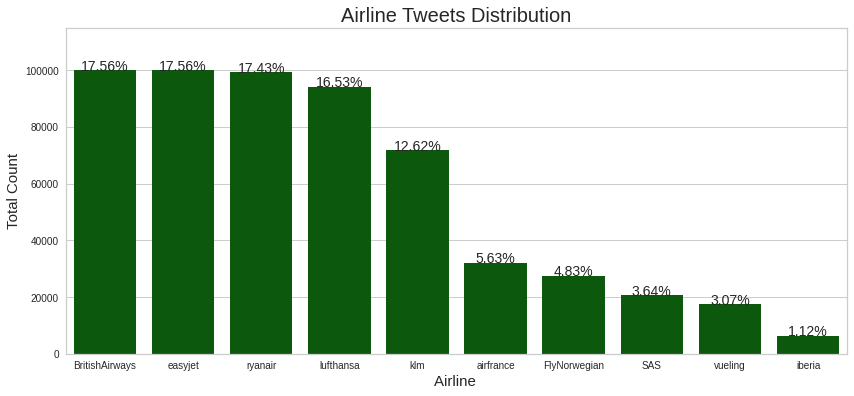

In [ ]:
import seaborn as sns
total = len(tweets_df)
plt.figure(figsize=(14,6))
grouped = tweets_df.groupby(["airline"]).count().reset_index()
grouped = grouped.sort_values("tweet",ascending = False)
g = sns.barplot(x='airline', y = "tweet",color='darkgreen',
                  data=grouped)
g.set_title("Airline Tweets Distribution", fontsize=20)
g.set_xlabel("Airline ", fontsize=15)
g.set_ylabel("Total Count", fontsize=15)

sizes=[]

for p in g.patches:
    height = p.get_height()
    sizes.append(height)
    g.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format((height/total)*100),
            ha="center", fontsize=14) 
    
g.set_ylim(0, max(sizes) * 1.15)
plt.show()

We limited the number of tweets per month to 10.000. British airways, Easyjet, and Ryanair reached the limit every month but we got less amount of tweets of other companies based in non-English speaking countries

Tweets distribution by Month

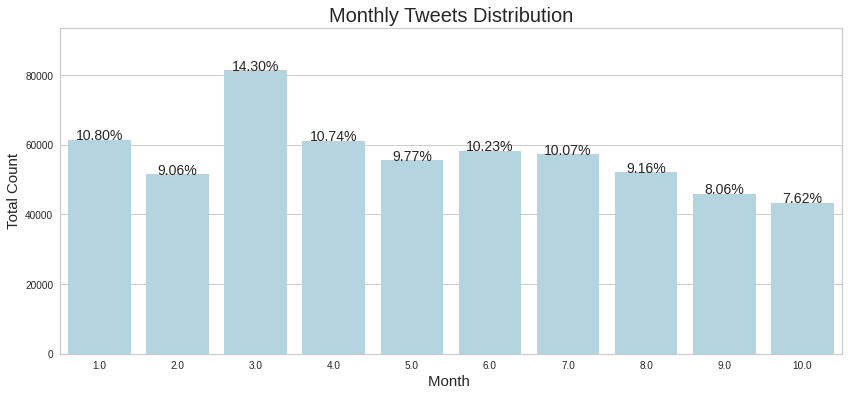

In [ ]:
plt.figure(figsize=(14,6))
tweets_df['date'] = pd.to_datetime(tweets_df['date'], errors='coerce', format='%Y-%m-%d %H:%M:%S')
grouped_date = tweets_df.groupby([tweets_df.date.dt.month]).tweet.count().reset_index()
grouped_date = grouped_date[grouped_date.date<11]
total = len(tweets_df)

g = sns.barplot(x='date', y = "tweet",color='lightblue',
                  data=grouped_date)
g.set_title("Monthly Tweets Distribution", fontsize=20)
g.set_xlabel("Month ", fontsize=15)
g.set_ylabel("Total Count", fontsize=15)

sizes=[]

for p in g.patches:
    height = p.get_height()
    sizes.append(height)
    g.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format((height/total)*100),
            ha="center", fontsize=14) 
    
g.set_ylim(0, max(sizes) * 1.15)
plt.show()

Here we can already see that March is a different month. More tweets were submitted during this month compared to the rest.

In [ ]:
tweets_length = tweets_df.copy()
tweets_length['len'] = tweets_length.tweet.apply(lambda x: len(x))

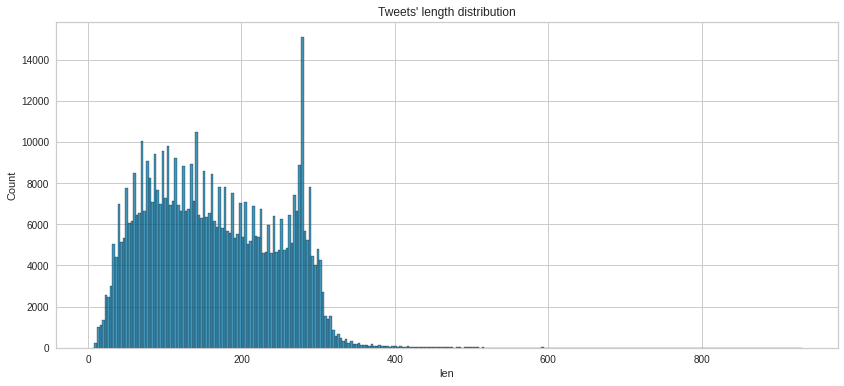

In [ ]:
plt.figure(figsize=(14,6))
g = sns.histplot(data = tweets_length,x="len",bins='auto')
g.set_title("Tweets' length distribution")
plt.show()

Here we can see that there are two main trends. Users used to the old twitter limitation of 140 characters and those who squeeze until the end the new twitter limitation of 280 characters.

## **3. Tools, theory and analysis**

This section is divided into two parts. First, we develop the network analysis to study the decrease of air traffic during these years and then analyze the tweets related to the selected airlines.

For the analysis, we used the plotly library in order to make our plots interactive so that it can be easier for the user to understand the data.

#### **3.1. Air traffic analysis using networks**

##### 3.1.1. Total air traffic analysis

In this section, we visualize the networks over time to evaluate the air traffic decrease from 2019 to 2020.

For the visualization of the network we used some network science tools. As mentioned previously, the nodes of the network represent the larger airports in Europe and the links represent the connections between them.

To have a better understanding of the data we added some attributes to our nodes and edges. For the nodes, the size of the bubbles represents the degree of the nodes (connections of the airports). Furthermore, we decided to group the nodes in different communities, so the colors of the bubbles correspond to the nodes' communities. For the communities partition we used the best partition of community Louvain, which maximises the modularity using Louvain heuristices.

For the edges, we coloured the connections according to the 10 selected airlines, and its weight correspond to the number of flights for each connection.



First, we plot the evolution over time of the whole air traffic in Europe for 2019 and 2020.

In [ ]:
def plot_plotly_slider(graphs, year):
  # Initialize figure
  fig = go.Figure()

  n = 0
  airline_buttons_dict = {k: list() for k in airline_codes}
  airline_buttons_list = list()
  steps = list()

  # calculate total edges in all graphs
  total_edges = 0

  for year_month, graph in graphs.items():
    edges_properties = dict()
    edges_properties["weight-color"] = list()
    for edge in graph.edges(data=True):
      edges_properties["weight-color"].append(str(edge[2]['weight']) + "-" + str(edge[2]['color']))

    edges_properties_unique = list(set(edges_properties["weight-color"]))
    total_edges += int(len(edges_properties_unique))

  # Add Traces
  for year_month, graph in graphs.items():
      iter_traces = 0

      # show initially only first plots
      if n==0:
        visibility = True
      else:
        visibility = False

      # Add nodes
      node_x = []
      node_y = []
      node_size = []
      for node in graph.nodes():
          x, y = positions[node]
          node_x.append(x)
          node_y.append(y)
          node_size.append(graph.degree[node]/30)

      partition = community_louvain.best_partition(graph)
      node_color = []
      for node, color in partition.items():  
        node_color.append(color)
      
      node_text = []
      for node, attr in graph.nodes(data=True):
          node_text.append(attr['name'])
      
      nodes_trace = go.Scattergeo(
                              lon=node_x,
                              lat=node_y,
                              visible=visibility,
                              mode='markers', #'markers',
                              hoverinfo='text',
                              marker=dict(size=node_size, color=node_color, showscale=False, colorscale='Rainbow', reversescale=True, colorbar=dict(
                                  thickness=15,
                                  title='Node Community',
                                  xanchor='left',
                                  titleside='right'
                              ),
                              line_width=0),
                              text = node_text
                              )
      
      # add nodes trace
      fig.add_trace(nodes_trace)
      iter_traces += 1
      
      # Add edges
      edges_properties = dict()
      edges_properties["weight-color"] = list()
      edges_properties["ori-dest_x"] = list()
      edges_properties["ori-dest_y"] = list()
      edges_properties["airline"] = list()
      for edge in graph.edges(data=True):
        edges_properties["weight-color"].append(str(edge[2]['weight']) + "-" + str(edge[2]['color']))
        edges_properties["ori-dest_x"].append([positions[edge[0]][0], positions[edge[1]][0]])
        edges_properties["ori-dest_y"].append([positions[edge[0]][1], positions[edge[1]][1]])
        edges_properties["airline"].append(str(edge[2]['airline']))

      edges_properties_unique = list(set(edges_properties["weight-color"]))
      edges_properties_dict = dict()

      for elem in edges_properties_unique:
        edges_properties_dict[elem] = dict()
        edges_properties_dict[elem]["x"] = [edges_properties["ori-dest_x"][i] for i, val in enumerate(edges_properties["weight-color"]) if val == elem]
        edges_properties_dict[elem]["y"] = [edges_properties["ori-dest_y"][i] for i, val in enumerate(edges_properties["weight-color"]) if val == elem]
        edges_properties_dict[elem]["airline"] = [edges_properties["airline"][i] for i, val in enumerate(edges_properties["weight-color"]) if val == elem]
      
      for k, v in edges_properties_dict.items():
        w = int(k.split("-")[0])/600
        c = str(k.split("-")[1])
        x_edges = [j for i in v['x'] for j in i]
        y_edges = [j for i in v['y'] for j in i]
        
        edges_trace = go.Scattergeo(
                                lon=x_edges,
                                lat=y_edges,
                                visible=visibility,
                                mode='lines',
                                hoverinfo='skip',
                                text=v['airline'],
                                line=dict(width=w, color=c)
                                )
        
        # add edges trace by weight-color
        fig.add_trace(edges_trace)

        iter_traces += 1
      
      step = dict(args = ['visible', n*[False] + iter_traces*[True] + (total_edges-n)*[False]],
                  label = (str(year_month)[5:7] + '/' + year[2:4]) )
      steps.append(step)

      n += iter_traces

  total_traces = n

  # Create sliders dict
  sliders = [dict(
                  active = 0,
                  currentvalue = {"prefix": "Month: "},
                  pad = {"b": 20, "t": 20},
                  steps = steps
                  )
            ]

  # Add dropdowns
  title = "Monthly networks for " + year
  fig.update_layout(
                    margin=dict(b=20,l=5,r=5,t=40),
                    title = go.layout.Title(text = title, x = 0.5, xanchor = 'center', yanchor = 'top'),
                    sliders = sliders,
                    title_font_size=16,
                    showlegend=False,
                    hovermode='closest',
                    geo = go.layout.Geo(scope = 'europe', projection = go.layout.geo.Projection(scale=1.5)),
                    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                    width=500,
                    height=600
  )

  # py.plot(fig, filename='2020_aviation_network')
  fig.show()
  filename = year + "_aviation_network.html"
  pio.write_html(fig, file='/content/drive/My Drive/Project/plots_html/' + filename, auto_open=True)

In [ ]:
plot_plotly_slider(G_months_2019, '2019')
plot_plotly_slider(G_months_2020, '2020')

By moving the slider the user can compare data from the same month of each year and visualize the difference. As expected, a big drop can be observed from the month of March again. 

##### 3.1.2. Air traffic analysis for airline

To go deeper in detail we analyze the affectation to 10 of the most important airlines in Europe: Air France, British Airways, EasyJet, Iberia, KLM, Lufthansa, Norwegian, Ryanair, Scandinavian Airlines and Vueling.

For this, we divide the main network into 10, which represent the air traffic for each airline.


In [ ]:
import plotly.graph_objects as go

def plot_plotly_sliders_airline(graphs, airline, year):
  data = []
  steps_intervals = []
  m = 0
  
  for year_month, graph in graphs.items():
    node_x = []
    node_y = []
    node_size = []
    for node in graph.nodes():
        x, y = positions[node]
        node_x.append(x)
        node_y.append(y)
        node_size.append(graph.degree[node]/30)

    import community as community_louvain
    partition = community_louvain.best_partition(graph)
    node_color = []
    for node, color in partition.items():  
      node_color.append(color)

    node_text = []
    for node, attr in graph.nodes(data=True):
        node_text.append(attr['name'])
    
    nodes_trace = []
    edges_trace = []

    # merge all the info in lists
    if m == 0:
      visibility = True
    else:
      visibility = False

    nodes_trace = dict(type='scattergeo',
                    lon = node_x,
                    lat = node_y,
                    mode = 'markers',
                    hoverinfo ='text',
                    marker = dict(size=node_size, color=node_color, showscale=False, colorscale='Rainbow', reversescale=True, colorbar=dict(
                            thickness=15,
                            title='Node Community',
                            xanchor='left',
                            titleside='right'),
                            line_width=0),
                    text = node_text,
                    visible = visibility)
    
    data.append(nodes_trace)
    
    for e in graph.edges(data = True):
      if e[2]['airline'] == airline:
        data.append(dict(type='scattergeo',
                      lon=[positions[e[0]][0], positions[e[1]][0]] ,
                      lat=[positions[e[0]][1], positions[e[1]][1]],
                      mode='lines',
                      hoverinfo = 'skip',
                      visible = visibility,
                      text = e[2]['airline'],
                      line=dict(width = (e[2]['weight']/200), color = e[2]['color']))) # edges
    steps_intervals.append(len(data))   
    m += 1

  # Figure set up
  fig = go.Figure()
  title = airline_names[airline] + " air traffic during " + year
  fig = go.Figure(data = data) 
  
  # Create sliders
  steps = []
  n = 0
  for i, date in enumerate(graphs.keys()):
    step = dict(
          args = ['visible', [False] * len(fig.data)],
          label = (str(date)[5:7] + '/' + year[2:4]))
    step['args'][1][n:steps_intervals[i]] = [True] * (steps_intervals[i]-n)
    steps.append(step)
    n = steps_intervals[i]

  sliders = [dict(
      active = 0,
      currentvalue = {"prefix": "Month: "},
      pad = {"b": 40, "t": 40},
      steps = steps
  )]

  fig.update_layout(
          title = go.layout.Title(text = title, x = 0.5, xanchor = 'center', yanchor = 'top'),
          titlefont_size=16,
          showlegend=False,
          geo = go.layout.Geo(scope = 'europe', projection = go.layout.geo.Projection(scale=1.5)),
          hovermode='closest',
          sliders = sliders,
          xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
          yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
          width=500,
          height=600,
          margin=dict(b=20,l=5,r=5,t=40)
  )

  title = airline + "_" + year + ".html"
  pio.write_html(fig, file='/content/drive/My Drive/Project/plots_html/' + title, auto_open=True)
  fig.show()

In [ ]:
# Visualization of the network
for airline in airline_codes:
  plot_plotly_sliders_airline(G_months_2019, airline, '2019')  
  plot_plotly_sliders_airline(G_months_2020, airline, '2020')  

### **3.2. Tweets analysis**

##### 3.2.1 Tweets cleaning


In [ ]:
# Loading data:
tweets_df = pd.read_csv("/content/drive/My Drive/Project/Tweets_data/Monthly tweets by company/tweets_data_monthly.csv")
tweets_df = tweets_df[['id', 'date', 'tweet', 'airline']]
tweets_df.head()

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.



,id,date,tweet,airline
0,1222667465030803461,2020-01-29 23:46:54+00:00,"@amanik Hi Aman, as you will see here https://...",lufthansa
1,1323566193488310272,2020-11-03 10:02:25+00:00,Design af højeste kvalitet: Oplev vores udvalg...,lufthansa
2,1222650396579127298,2020-01-29 22:39:04+00:00,Thank you for suspending all flights to mainla...,lufthansa
3,1222649092540596224,2020-01-29 22:33:54+00:00,"@Esom2106 Hi, please allow me to answer in Eng...",lufthansa
4,1222647703215038464,2020-01-29 22:28:22+00:00,@lufthansa clearly isnt interested in providin...,lufthansa


We want to remove stop words from the tweet because they are not relevant in terms of analysis.

In [ ]:
def check_token(t: spacy.tokens.Token):
    if t.is_stop:
        return False

    return True

After we define a function to remove all punctuation characters and stay only with plain text.

In [ ]:
def keep_text_only(text):
    text = text.replace(string.punctuation, "")
    tokens = text.split()
    tokens = [token for token in tokens if token.isalpha()] #alternative .isalnum
    tokens = " ".join(tokens)
    
    return tokens    

Finally, we define the function that will call the previous ones and apply nlp (lemmatization and lowecase) to the text.

In [ ]:
def clean_text(nlp: spacy.lang, texts: List[str]):
    texts = [keep_text_only(text) for text in texts]
    cleaned_texts = []

    for doc in nlp.pipe(texts):

        cleaned_tokens = [token.lemma_.lower() for token in doc 
                          if check_token(token)]  

        cleaned_texts.append(cleaned_tokens)

    return cleaned_texts

In [ ]:
#load in the pre-trained model for english text from spacy and add a language detector
nlp = spacy.load("en_core_web_sm", disable=["ner", "parser"]) 
nlp.add_pipe(nlp.create_pipe('sentencizer'))

We apply the function to the tweets and save it in another column of the dataset "clean_tweet".

In [ ]:
texts = tweets_df.tweet.map(str).to_list()

results = clean_text(nlp, texts)

In [ ]:
results_words = [word for sublist in results for word in sublist]

In [ ]:
results_text = [" ".join(sublist) for sublist in results]

In [ ]:
tweets_df["clean_tweet"] = results_text

In [ ]:
#tweets_df.to_csv("/content/drive/My Drive/Project/Tweets_data/all_tweets_with_cleaned_monthly_categories_sentiment.csv")

##### 3.2.2. Most frequent terms

Load and prepare data

In [ ]:
#tweets_df = pd.read_csv("/content/drive/My Drive/Project/Tweets_data/all_tweets_with_cleaned_monthly.csv")
tweets_df["clean_tweet"] = tweets_df["clean_tweet"].astype("string")
tweets_df['date'] = pd.to_datetime(tweets_df['date'], errors='coerce', format='%Y-%m-%d %H:%M:%S')

Now we want to analyze and develop visualizations of the most frequently used terms in every tweet in every month. To do so we start by applying the wordcloud function from nltk and storing all the outputs in a dataset to plot it after using plotly.

In [ ]:

df_wordcloud = pd.DataFrame(columns =["date","word_list","new_freq_list","freq_list","fontsize_list","x_arr","y_arr","orientation_list","color_list"])
for month in range(1,11,1):
    complaints_text = list(tweets_df[tweets_df.date.dt.month ==month]["clean_tweet"].dropna().values)



    # join all documents in corpus
    text = " ".join(list(complaints_text))

    word_cloud = WordCloud(stopwords=set(STOPWORDS), max_words=20, max_font_size=30)
    word_cloud.generate(text)

    word_list = []
    freq_list = []
    fontsize_list = []
    position_list = []
    orientation_list = []
    color_list = []

    for (word, freq), fontsize, position, orientation, color in word_cloud.layout_:
        word_list.append(word)
        freq_list.append(freq)
        fontsize_list.append(fontsize)
        position_list.append(position)
        orientation_list.append(orientation)
        color_list.append(color)

    # get the positions
    x_arr = []
    y_arr = []
    for i in position_list:
        x_arr.append(i[0]*1.2)
        y_arr.append(i[1]*1.6)

    # get the relative occurence frequencies
    new_freq_list = []
    x_arr = list(range(1,301,15))
    y_arr = list(range(1,901,45))
    random.shuffle(y_arr)
    random.shuffle(x_arr)
    for l in freq_list:
        new_freq_list.append(l * 80)
    df_wordcloud = df_wordcloud.append({'date': month,"word_list":word_list,"new_freq_list":new_freq_list,"freq_list":freq_list,"fontsize_list":fontsize_list,"x_arr":x_arr,"y_arr":y_arr,"orientation_list":orientation_list,"color_list":color_list}, ignore_index=True)
    print("Month ",month,"is ready.")


Month  1 is ready.
Month  2 is ready.
Month  3 is ready.
Month  4 is ready.
Month  5 is ready.
Month  6 is ready.
Month  7 is ready.
Month  8 is ready.
Month  9 is ready.
Month  10 is ready.


Now that we have the data ready, we can plot interactive temporal wordclouds using plotly's scatter plot.

In [ ]:
months = sorted(list(range(1,11,1)))
data = []
## create sliders
steps = []
for i, month in enumerate(months):
    step = dict(
        args = ['visible', [False] * len(months) ],
        label= month)
    step['args'][1][i] = True 
    steps.append(step)

sliders = [dict(
    active = 0,
    currentvalue = {"prefix": "Month: "},
    pad = {"b": 40, "t": 40},
    steps = steps
)]
## data

for month in months:
    mask = (df_wordcloud.date.values == month)
    trace = (dict(visible = False,
        type = "scatter",
        x=df_wordcloud[df_wordcloud.date==month].x_arr.to_list()[0],
        y=df_wordcloud[df_wordcloud.date==month].y_arr.to_list()[0],
        textfont=dict(size=df_wordcloud[df_wordcloud.date==month].new_freq_list.values[0], color=df_wordcloud[df_wordcloud.date==month].color_list.to_list()[0]),
        hoverinfo="text",
        textposition="top center",
        hovertext=["{0} - {1}".format(w, f) for w, f in zip(df_wordcloud[df_wordcloud.date==month].word_list.to_list()[0], df_wordcloud[df_wordcloud.date==month].freq_list.to_list()[0])],
        mode="text",
        text=df_wordcloud[df_wordcloud.date==month].word_list.to_list()[0],
        ))
               
    data.append(trace)

data[int(1)]['visible'] = True
## merge it together
layout = (
        {"autosize":False,
          "width":1000,
        "height":700,
            "sliders":sliders,
            "xaxis": {
                "showgrid": False,
                "showticklabels": False,
                "zeroline": False,
                "automargin": True,
                "range": [-200, 450],
            },
            "yaxis": {
                "showgrid": False,
                "showticklabels": False,
                "zeroline": False,
                "automargin": True,
                "range": [-50, 1000],
            },
            "margin": dict(t=20, b=20, l=10, r=10, pad=4),
            "hovermode": "closest",
        }
    )
fig = dict(data=data, layout=layout)

pio.show(fig)
#pyo.iplot(fig, filename='Flights Wordcloud')

Plot interactive barchart relative frequency-term by month. With this visualization we aim at better look at the different relative frequencies for every expression.

In [ ]:

months = sorted(list(range(1,11,1)))
data = []
## create sliders
steps = []
for i, month in enumerate(months):
    step = dict(
        args = ['visible', [False] * len(months) ],
        label= month)
    step['args'][1][i] = True 
    steps.append(step)

sliders = [dict(
    active = 0,
    currentvalue = {"prefix": "Month: "},
    pad = {"b": 40, "t": 40},
    steps = steps
)]
## data

for month in months:
    mask = (df_wordcloud.date.values == month)
    df_plot = pd.DataFrame(columns = ["word_list","freq_list"])
    df_plot['word_list'] = df_wordcloud[df_wordcloud.date==month].head(20).word_list.to_list()[0]
    df_plot['freq_list'] = df_wordcloud[df_wordcloud.date==month].head(20).freq_list.to_list()[0]
    trace = (dict(visible = False,
        type = "bar",
        x=df_plot['word_list'],
        y=df_plot['freq_list'],
       
        ))
               
    data.append(trace)
data[int(1)]['visible'] = True
## merge it together
layout = (
        {"autosize":False,
          "width":1000,
        "height":700,
         "sliders":sliders,
            
        }
    )
fig = dict(data=data, layout=layout)
pio.show(fig)
#pyo.iplot(fig, filename='Flights Wordcloud')

As the graphs show, in January and February, the most frequently used terms are "flight", "fly", "airport" or "time". These are words associated with the normal operation of flights. However, March is the turning point, the terms that start appearing for the first time among the most frequent ones are "cancel flight" y "flight cancel", which take the first position in terms of relative frequency. Other relevant terms that have increased their frequency in March are "customer service", "refund flight" and "change flight".

In April is when we start seeing a big change in the most used words on Twitter. Firstly, we can see that the relative frequency of the top 20 expressions is quite higher than the rest of the months. This fact shows that in this month most of the tweets include these words ("change flight", "claim voucher", "provide information" or "voucher understand").

For the months after April, we can still find these terms among the most common. Not to the same degree as in March or April, but expressions such as "pay", "refund" or "cancel flight" are repeated constantly over the year until October.


##### 3.2.2. NMF

The following explanation of NMF is extracted from (https://towardsdatascience.com/topic-modeling-articles-with-nmf-8c6b2a227a45):

Non-Negative Matrix Factorization (NMF) is an unsupervised technique so there are no labeling of topics that the model will be trained on. The way it works is that, NMF decomposes (or factorizes) high-dimensional vectors into a lower-dimensional representation. These lower-dimensional vectors are non-negative which also means their coefficients are non-negative.

Using the original matrix (A), NMF will give you two matrices (W and H). W is the topics it found and H is the coefficients (weights) for those topics. In other words, A is articles by words (original), H is articles by topics and W is topics by words.

What we want to do in this case is to identify the different clusters across all tweets.

In [ ]:
# Loading data:
# tweets_df = pd.read_csv("/content/drive/My Drive/Project/Tweets_data/all_tweets_with_cleaned_monthly.csv")
# tweets_df = tweets_df[['id', 'date', 'tweet', 'airline', 'clean_tweet']]
tweets_df['airline'] = tweets_df.airline.str.replace("_","")
# tweets_df.head()

In [ ]:
# Set configuration parameters for TF-IDF extractors:
MAX_OCCURENCE_FRAC = 0.85
MIN_OCCURENCE_RATE = 3
NUM_FEATURES = len(tweets_df) # total number of tweets

In [ ]:
# Split the cleaned text into lists of words:
tokens = tweets_df["clean_tweet"].astype(str).apply(lambda x: x.split()).tolist()

In [ ]:
# Initialize TF-IDF vectorizer - See sklearn for documentation on parameters:
tfidf_vectorizer = TfidfVectorizer(
    lowercase=False,
    ngram_range = (1, 2),
    tokenizer = lambda x: x,  # Because we already have split the texts into words
    max_df = MAX_OCCURENCE_FRAC,
    min_df = MIN_OCCURENCE_RATE,
    max_features = NUM_FEATURES,
    norm="l2")

In [ ]:
# Calculate the TF-IDF representation - A matrix of Number of tweets x Number of TF-IDF words:
features = tfidf_vectorizer.fit_transform(tokens)

We want to train the model to find 20 clusters.

In [ ]:
# Initialize and run the NMF model on the TF-IDF encodings - Here we find 20 components/clusters:
model = NMF(n_components=20, random_state=42, alpha=.1, l1_ratio=.5, init="nndsvd")

clusters = model.fit_transform(features)

In [ ]:
# Create a mapping from column number to column name:
feature_to_token = {value: key for key, value in tfidf_vectorizer.vocabulary_.items()}

In [ ]:
# The the top 10 most significant words for each cluster:
top_topic_tokens = []
for row in model.components_:
    top_token_ids = row.argsort(axis=0)[-10:][::-1].tolist()
    top_tokens = [feature_to_token[id] for id in top_token_ids]
    top_topic_tokens.append(top_tokens)

The most significant words for every cluster are:

In [ ]:
# Print the most significant words for each cluster:
for i, topic in enumerate(top_topic_tokens):
    print(f"{i}: {' - '.join(topic)}")

0: thank - thank support - support - dm thank - thank send - hi thank - reply thank - thank reply - great - appreciate
1: refund - request - refund flight - wait refund - receive - refund cancel - request refund - process - cancel - receive refund
2: send - send dm - hi send - message - code - send book - book code - dm send - thank send - assist send
3: reply - reply dm - hi reply - reply thank - hello reply - thank reply - wait reply - reply emily - hi - reply direct
4: flight - cancel - cancel flight - flight cancel - book - change - refund flight - refund cancel - book flight - return
5: thank help - hub provide - help hub - provide information - hub - free claim - voucher understand - refund visit - understand refund - information need
6: need - help - ask - contact need - need confirm - confirm - question - contact - possible - reference
7: العيد تتحدث - aleid porject - porject - porject مارسيل - العيد - مارسيل العيد - introduction marcelle - arabic introduction - مارسيل - عن
8: 

##### 3.2.3. Inspection of the distribution of the tweets across clusters:

In [ ]:
# Find the clusters:
topic_extraction = np.argmax(clusters, axis=1)

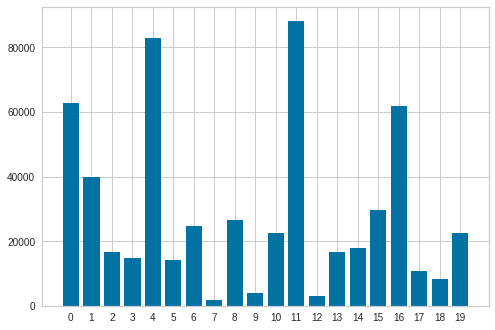

In [ ]:
# Visualize the distribution of mails:
fig, ax = plt.subplots()
ax.set_xticks(range(clusters.shape[1]))
fig = plt.hist(topic_extraction, bins=np.array(range(clusters.shape[1]+1))-0.5, rwidth=0.8)

The most significant clusters are 0, 4, 11, and 16. 0: Is about appreciation tweets, expressions 4: Is about the cancellation of flights. We can see that is quite representative. 11: This is the most representative one and it is about customer service 16: This group is about payments and refunds.

These largest clusters represent quite well the situation lived by the airline industry over 2020.

##### 3.2.4. Semi-supervised text clustering:

In this part, we want to categorize the topic of every tweet. To do so we are going to use RoBERTa which is a pre-trained model built by Facebook that is used to predict categories based on the labels that the user inputs. RoBERTa has been built on top of BERT which is another pretraining model. More about RoBERTa can be found in this paper. https://arxiv.org/abs/1907.11692



In [ ]:
# Function for only keeping purely charater-based tokens:
def keep_text_only(text):
    text = text.replace(string.punctuation, "")
    tokens = text.split()
    tokens = [token for token in tokens if token.isalpha()]
    tokens = " ".join(tokens)
    return tokens

In [ ]:
# Loading data:
#tweets_df = pd.read_csv("/content/drive/My Drive/Project/Tweets_data/all_tweets_with_cleaned_monthly.csv")
#tweets_df = tweets_df[['id', 'date', 'tweet', 'airline','clean_tweet']]

In [ ]:
# Clean out any word consisting of anything non alphabetical:
tweets_df["text"] = tweets_df["clean_tweet"].astype(str).apply(keep_text_only)

In this part we define the labels we want that RoBERTa model predicts. After several trials. The ones that we found relevant has been "delays", "luggage", "cancellations", "refunds", "customer service" and "price".

In [ ]:
# Define cluster descriptions and their labels:
TRANSFORMER_TOPIC_LABELS = {
            "This concerns a delay": "delays",
            "This concerns a luggage problem, lost luggage": "luggage",
            "This concerns a cancellation": "cancellations",
            "This concerns a refund": "refunds",
            "This concerns customer service": "customer service",
            "This concerns price observation": "price"
}

In [ ]:
# Create a label number to description lookup:
LABEL_TO_TOPIC = {i:k for i, (k, _) in enumerate(TRANSFORMER_TOPIC_LABELS.items())}

In [ ]:
# Load model - the dictionary below lists some of the possible models, see sentence_transformer github for more:
MODEL_NAME = {
    "ROBERTA": "roberta-large-nli-stsb-mean-tokens",
    "BERT": "bert-large-nli-stsb-mean-tokens",
    "DISTILBERT": "distilbert-base-nli-stsb-mean-tokens"
}

MODEL = SentenceTransformer(MODEL_NAME["ROBERTA"])

100%|██████████| 1.31G/1.31G [00:45<00:00, 28.7MB/s]


In [ ]:
# Calculate the numerical representations for each cluster from their description texts:
LABEL_EMBEDDINGS = MODEL.encode(sentences = list(TRANSFORMER_TOPIC_LABELS.keys()), output_value="sentence_embedding", convert_to_numpy=False,
                                is_pretokenized=False, device="cuda") # If on CPU device="cpu"

In [ ]:
# Calcualte the numerical representations for each tweet:
embeddings = MODEL.encode(sentences=tweets_df["text"], batch_size=128, show_progress_bar=True,
                                output_value="sentence_embedding", convert_to_numpy=False,
                                is_pretokenized=False, device="cuda", num_workers=multiprocessing.cpu_count()) # If on CPU device="cpu"

In [ ]:
# Calculate the similarities between mail correspondances and each cluster description:
for i, label in enumerate(list(TRANSFORMER_TOPIC_LABELS.values())):
    tweets_df[label] = F.cosine_similarity(torch.stack([tensor for tensor in embeddings]).view(-1, 1024), LABEL_EMBEDDINGS[i].view(1, 1024)).data.tolist()

In [ ]:
# Function for giving a tweet a single cluster by attributing the most similar cluster description:
def predict_single_cluster(text):
    representation = MODEL.encode(sentences=text
                                  , output_value="sentence_embedding"
                                  , convert_to_numpy=False
                                  , is_pretokenized=False
                                  , device="cuda"
                                  , num_workers=multiprocessing.cpu_count())
    predicted_label_index = F.cosine_similarity(representation.view(-1, 1024)
                                , torch.stack([tensor for tensor in LABEL_EMBEDDINGS]).view(-1, 1024)).argmax().data.tolist()
    return list(TRANSFORMER_TOPIC_LABELS.keys())[predicted_label_index]

Here you can find an example on the result of the prediction made by the model:

In [ ]:
i = 0
for index, tweet in tweets_df.iterrows():
  print(tweet["tweet"])
  print("delays: ")
  print(tweet["delays"])
  print("luggage: ")
  print(tweet["luggage"])
  print("cancellations: ")
  print(tweet["cancellations"])
  print("refunds: ")
  print(tweet["refunds"])
  print("customer service: ")
  print(tweet["customer service"])
  print("price: ")
  print(tweet["price"])
  print(predict_single_cluster(str(tweet["clean_tweet"])))
  
  print("\n")

  i += 1
  if i > 50:
    break

@amanik Hi Aman, as you will see here https://t.co/v5bFU1zbOK HKG is not included at all. /Jack
delays: 
0.038365863263607025
luggage: 
0.058789435774087906
cancellations: 
0.036738503724336624
refunds: 
0.07153505086898804
customer service: 
0.10268840193748474
price: 
0.05819353833794594
This concerns customer service


Design af højeste kvalitet: Oplev vores udvalg af lys "Lys til hus og have". Til belysning af høj kvalitet i private haver og opholdsstuer.
delays: 
-0.002542623085901141
luggage: 
0.115479975938797
cancellations: 
0.006115753669291735
refunds: 
-0.007146395742893219
customer service: 
-0.02770259417593479
price: 
0.08047325164079666
This concerns a luggage problem, lost luggage


Thank you for suspending all flights to mainland China. I only know of you 2 who’ve done it so far &amp; I very much appreciate it. You should’ve done it a week ago but whatever. We in Toronto can’t have the film industry destroyed again like we did after sars. @AirCanada @lufthansa
delays: 

We add here the categories for every tweet in another column.

In [ ]:
tweets_df['prediction'] = tweets_df[['delays','luggage','cancellations','refunds','price','customer service']].idxmax(axis=1)
tweets_df['max_prediction'] =tweets_df[['delays','luggage','cancellations','refunds','price','customer service']].max(axis=1)

In [ ]:
#tweets_df.to_csv("/content/drive/My Drive/Project/Tweets_data/predictions.csv")

##### 3.2.5. Interactive plot, distribution of tweets by airline and category

Once we have the data. We want to start exploring it by developing relevant visualization to enhance user experience and identifying trends. For the visualizations we are using plotly.

First we would like to see how the different categories are changing as a percentage of every month's subtotal.

In [ ]:
tweets_df_grouped = tweets_df.copy(deep = True)
tweets_df_grouped['date'] = pd.to_datetime(tweets_df_grouped['date'], errors='coerce', format='%Y-%m-%d %H:%M:%S')
tweets_df_grouped = tweets_df_grouped.groupby([tweets_df_grouped.date.dt.month,tweets_df_grouped.prediction]).agg({'luggage':'size'}) \
       .rename(columns={'luggage':'count'}) \
       .reset_index()

In [ ]:
ls = []
subtotals = tweets_df_grouped.groupby(tweets_df_grouped.date).sum().reset_index()
for i,data in tweets_df_grouped.iterrows():
    ls.append((data["count"]/subtotals[subtotals.date == data["date"]]["count"].values[0] )*100)
tweets_df_grouped["subpercentage"]=ls

In [ ]:
months_string = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct"]
fig = px.bar(tweets_df_grouped[tweets_df_grouped.date<11], x="date", y="subpercentage",color = "prediction",labels={
                     "date": "Month",
                     "subpercentage": "% category"
                 }, title="Distribution of predicted categories by month over 2020")

pio.show(fig)

By looking at the graph from above, we can see that there is an increase of tweets related to cancellations in March and there has been a significant increase of tweets related to refunds from April onwards compared to January and February. At the same time, we can observe how luggage-related tweets have been diluted during the period of inactivity of the airlines.

But now we want to take a look at the distribution of tweets by categories and by airlines over time.

In [ ]:
tweets_df_grouped = tweets_df.copy(deep = True)
tweets_df_grouped['date'] = pd.to_datetime(tweets_df_grouped['date'], errors='coerce', format='%Y-%m-%d %H:%M:%S')
tweets_df_grouped = tweets_df_grouped.groupby([tweets_df_grouped.airline,tweets_df_grouped.date.dt.month,tweets_df_grouped.prediction]).luggage.count().reset_index()
tweets_df_grouped.head()

,airline,date,prediction,luggage
0,BritishAirways,1.0,cancellations,714
1,BritishAirways,1.0,customer service,1921
2,BritishAirways,1.0,delays,1194
3,BritishAirways,1.0,luggage,2730
4,BritishAirways,1.0,price,1629


In [ ]:
airlines = tweets_df_grouped['airline'].unique().tolist()
months_string = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct"]
months = sorted(list(range(1,11,1)))
predictions = tweets_df_grouped['prediction'].unique().tolist()
data = []
b2_labels = airlines
matr = np.eye(len(b2_labels)*len(predictions))
matr2=[]
for i in range(0,len(matr),len(predictions)):
    nl = [0] * len(b2_labels)*len(predictions)
    for l in range(len(predictions)):
        nl = nl +matr[i+l]
    matr2.append(nl)

b2_show = [list(b) for b in [e==1 for e in matr2]]
buttons2=[]



for i in range(0, len(b2_labels)):
    buttons2.append(dict(method='update',
                        label=b2_labels[i],
                        args=[{'visible':b2_show[i]}]
                        )
                   )
## data

for airline in airlines:
    #mask = (df_wordcloud.date.values == month)
    df_plot = pd.DataFrame(columns = ["month","prediction","count"])
    df_plot['month'] = tweets_df_grouped[tweets_df_grouped.airline==airline]["date"]
    df_plot['prediction'] = tweets_df_grouped[tweets_df_grouped.airline==airline]["prediction"]
    df_plot['count'] = tweets_df_grouped[tweets_df_grouped.airline==airline]["luggage"]
    
    for pred in predictions:
        trace = (dict(visible = False,
            type = "bar",
            x=months_string  ,
            y=df_plot[df_plot["prediction"]==pred]['count'],
            name = pred

            ))
        data.append(trace)   
    
for vis in range(6):
    data[vis]["visible"] = True
## merge it together

updatemenu=[]
your_menu2=dict()
updatemenu.append(your_menu2)

updatemenu[0]['buttons']=buttons2
updatemenu[0]['y']=1.185
updatemenu[0]["direction"] = "down"
updatemenu[0]["pad"] = {"r": 10, "t": 10}         
updatemenu[0]['x']=0.07
updatemenu[0]['xanchor'] = "left"
updatemenu[0]['yanchor'] = "top"
 

layout = (
        {"autosize":False,
          "width":1000,
        "height":700,
         
        "title":{
        'text': "Distribution of Tweets by Airline, Month and Category",
        'y':0.9,
        'x':0.53,
        'xanchor': 'center',
        'yanchor': 'top'},
         "updatemenus":updatemenu,
            "barmode":"group",
         "annotations":[
         {"text":"Select Airline", "x":-0.05, "xref":"paper", "y":1.175, "yref":"paper",
                             "align":"left", "showarrow":False}],
         
         "xaxis":dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
                dict(count=6,
                     label="6m",
                     step="month",
                     stepmode="backward")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="category"
    )
    
        }
    )



fig = dict(data=data, layout=layout)


pio.show(fig)
#pyo.iplot(fig, filename='Categories')

##### 3.2.6. Sentiment analysis

Defining the function to calculate sentiment using Vader from nltk.

In [ ]:
sent_analysis = SentimentIntensityAnalyzer()
def nltk_sentiment(review):
    vs = sent_analysis.polarity_scores(review)
    
    if not vs['neg'] > 0.05:
        score = vs['pos']- vs['neg']
        if score > 0:
  
            return score
        else:
            
            return 0
    elif not vs['pos'] > 0.05:
        score = vs['pos']- vs['neg']
        if score <= 0:
            
            return score
        else:
            
            return 0
    else:
        
        return 0

In [ ]:
tweets_df['clean_tweet'] = tweets_df.clean_tweet.astype("string")

In [ ]:
tweets_df['score'] = tweets_df["text"].apply(lambda x: nltk_sentiment(x))

In [ ]:
tweets_df_grouped.head()

,airline,date,prediction,luggage
0,BritishAirways,1.0,cancellations,714
1,BritishAirways,1.0,customer service,1921
2,BritishAirways,1.0,delays,1194
3,BritishAirways,1.0,luggage,2730
4,BritishAirways,1.0,price,1629


Grouping the data to plot

In [ ]:
tweets_df_grouped = tweets_df.copy(deep = True)
tweets_df_grouped['date'] = pd.to_datetime(tweets_df_grouped['date'], errors='coerce', format='%Y-%m-%d %H:%M:%S')
tweets_df_grouped = tweets_df_grouped.groupby([tweets_df_grouped.airline,tweets_df_grouped.date.dt.month,tweets_df_grouped.prediction]).agg({'luggage':'size', 'score':'mean'}) \
       .rename(columns={'luggage':'count','score':'mean_sent'}) \
       .reset_index()

Creating the interactive plot.

In [ ]:
airlines = tweets_df_grouped['airline'].unique().tolist()
months_string = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct"]
months = sorted(list(range(1,11,1)))
predictions = tweets_df_grouped['prediction'].unique().tolist()
data = []
b2_labels = airlines
matr = np.eye(len(b2_labels)*len(predictions))
matr2=[]
for i in range(0,len(matr),len(predictions)):
    nl = [0] * len(b2_labels)*len(predictions)
    for l in range(len(predictions)):
        nl = nl +matr[i+l]
    matr2.append(nl)

b2_show = [list(b) for b in [e==1 for e in matr2]]
buttons2=[]



for i in range(0, len(b2_labels)):
    buttons2.append(dict(method='update',
                        label=b2_labels[i],
                        args=[{'visible':b2_show[i]}]
                        )
                   )
## data

for airline in airlines:
    #mask = (df_wordcloud.date.values == month)
    df_plot = pd.DataFrame(columns = ["month","prediction","count"])
    df_plot['month'] = tweets_df_grouped[tweets_df_grouped.airline==airline]["date"]
    df_plot['prediction'] = tweets_df_grouped[tweets_df_grouped.airline==airline]["prediction"]
    df_plot['count'] = tweets_df_grouped[tweets_df_grouped.airline==airline]["mean_sent"]
    
    for pred in predictions:
        trace = (dict(visible = False,
            type = "bar",
            x=months_string  ,
            y=df_plot[df_plot["prediction"]==pred]['count'],
            name = pred

            ))
        data.append(trace)   
    
for vis in range(6):
    data[vis]["visible"] = True
## merge it together

updatemenu=[]
your_menu2=dict()
updatemenu.append(your_menu2)

updatemenu[0]['buttons']=buttons2
updatemenu[0]['y']=1.189
updatemenu[0]["direction"] = "down"
updatemenu[0]["pad"] = {"r": 10, "t": 10}         
updatemenu[0]['x']=0.07
updatemenu[0]['xanchor'] = "left"
updatemenu[0]['yanchor'] = "top"
 

layout = (
        {"autosize":False,
          "width":1000,
        "height":700,
         #"legend_title":"Predicted Category",
        "title":{
        'text': "Average tweets sentiment according to predicted category in 2020",
        'y':0.9,
        'x':0.53,
        'xanchor': 'center',
        'yanchor': 'top'},
         "yaxis_title":"Sentiment Score",
         "updatemenus":updatemenu,
            "barmode":"group",
         "annotations":[
         {"text":"Select Airline", "x":-0.05, "xref":"paper", "y":1.175, "yref":"paper",
                             "align":"left", "showarrow":False}],
         
         "xaxis":dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
                dict(count=6,
                     label="6m",
                     step="month",
                     stepmode="backward")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="category"
    )
    
        }
    )



fig = dict(data=data, layout=layout)

pio.show(fig)
#pyo.iplot(fig, filename='Flights Wordcloud')

In [ ]:
tweets_df_grouped = tweets_df_grouped.groupby(["airline","prediction"]).mean_sent.mean().reset_index() 

In [ ]:
for pred in tweets_df_grouped.prediction.unique():
  print(tweets_df_grouped[tweets_df_grouped.mean_sent == tweets_df_grouped[tweets_df_grouped.prediction == pred].mean_sent.max()])

   airline     prediction  mean_sent
36     klm  cancellations  -0.044186
      airline        prediction  mean_sent
19  airfrance  customer service   0.268593
   airline prediction  mean_sent
38     klm     delays    0.05939
   airline prediction  mean_sent
15     SAS    luggage   0.088506
   airline prediction  mean_sent
40     klm      price   0.104402
          airline prediction  mean_sent
5  BritishAirways    refunds   0.209558


In [ ]:
for pred in tweets_df_grouped.prediction.unique():
  print(tweets_df_grouped[tweets_df_grouped.mean_sent == tweets_df_grouped[tweets_df_grouped.prediction == pred].mean_sent.min()])

    airline     prediction  mean_sent
48  ryanair  cancellations  -0.141775
    airline        prediction  mean_sent
49  ryanair  customer service    0.15215
    airline prediction  mean_sent
26  easyjet     delays  -0.020738
    airline prediction  mean_sent
51  ryanair    luggage  -0.002842
    airline prediction  mean_sent
52  ryanair      price   0.048503
    airline prediction  mean_sent
53  ryanair    refunds   0.099151



We can see is that on average, KLM, SAS, and British Airways have the best sentiment valuations for every category. Whereas Ryanair and EasyJet show the lowest sentiment score.

## **4. Discussion**

To conclude, with the outcome of the analysis we accomplished the goal of the study as it has been possible to show in a quantitative manner the actual impact of Covid-19 in the aviation industry.  
The network analysis has provided a clear overview of the drop in the number of flights for 2020 compared to the same periods in 2019. Then, the twitter analysis have unveiled that indeed there has been a temporal relationship between Twitter user's reflections and the change of the size of the flights' network over time.  

As future work, we propose to see if it is possible to forecast the number of flights for each company depending on the increase or decrease in number of tweets regarding cancellations or refunds.

## **5. Contributions**

During this project Arnau has taken the leading role and did the preprocessing and cleaning of the data, afterwards he has been supporting both parts of the project (networks and text analysis). Berta has been mainly focused in the networks analysis and Hector in the Text analysis.  
However, we must highlight the great collaboration during the work, so everyone has been aware and contributing to each other part.